Hello fellow Kagglers,

This notebook is a first draft for this competition and is shared to get people started.

* V1 Shows the training process
* V2 Uses the precomputed DataFrames and pretrained model to make the inference
* V3 More plots and filtering data based on sample submission min/max
* V5 Excluding samples based on 0.1%< or >99.9% of train samples since sample submission is updated. Thanks to [Myrthe deen](https://www.kaggle.com/myrthedeen) for pointing this out.

# Imports

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import imageio.v3 as  imageio
import albumentations as A

from albumentations.pytorch import ToTensorV2
from torch.utils.data import Dataset, DataLoader
from torch import nn
from tqdm.notebook import tqdm
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from torchvision import transforms

import torch
import timm
import glob
import torchmetrics
import time
import psutil
import os
import math
import warnings

tqdm.pandas()

# Config

In [2]:
class Config():
    IMAGE_SIZE0 = 512
    IMAGE_SIZE = 288
    TARGET_COLUMNS = ['X4_mean', 'X11_mean', 'X18_mean', 'X50_mean', 'X26_mean', 'X3112_mean']
    TARGET_COLUMNS_TEST = ['X4', 'X11', 'X18', 'X50', 'X26', 'X3112']
    N_TARGETS = len(TARGET_COLUMNS)
    # Dataset
    RECOMPUTE_DATAFRAMES = True
    BATCH_SIZE = 24
    BATCH_SIZE_VAL = 128
    N_VAL_SAMPLES0 = 4096
    # Training
    LR_MAX = 3e-4
    WEIGHT_DECAY = 0.01
    N_EPOCHS = 12
    TRAIN_MODEL = True
    # Others
    IS_INTERACTIVE = os.environ['KAGGLE_KERNEL_RUN_TYPE'] == 'Interactive'
    SEED = 42
    EPS = 1e-6
    EPS_CUDA = torch.tensor([EPS]).to('cuda')
        
CONFIG = Config()

# Train DataFrame

In [3]:
if CONFIG.RECOMPUTE_DATAFRAMES:
    train0 = pd.read_csv('/kaggle/input/planttraits2024/train.csv')

    # Add File Path
    train0['file_path'] = train0['id'].apply(lambda s: f'/kaggle/input/planttraits2024/train_images/{s}.jpeg')

    # Reaed Raw Image JPEG Bytes
    train0['jpeg_bytes'] = train0['file_path'].progress_apply(lambda fp: open(fp, 'rb').read())
    
    # Save for Future Use
    train0.to_pickle('train.pkl')
else:
    train0 = pd.read_pickle('/kaggle/input/planttraits2024-eda-training-pub-dataset/train.pkl')
    
# Assign Medians
CONFIG.TARGET_MEDIANS = train0[CONFIG.TARGET_COLUMNS].median(axis=0).values

  0%|          | 0/55489 [00:00<?, ?it/s]

In [4]:
# Split train in train/val
train, val = train_test_split(train0, test_size=CONFIG.N_VAL_SAMPLES0, shuffle=True, random_state=CONFIG.SEED)

train = train.reset_index(drop=True)
val = val.reset_index(drop=True)
    
# Display DataFrame
display(train.head(30))
display(train.info())

,id,WORLDCLIM_BIO1_annual_mean_temperature,WORLDCLIM_BIO12_annual_precipitation,WORLDCLIM_BIO13.BIO14_delta_precipitation_of_wettest_and_dryest_month,WORLDCLIM_BIO15_precipitation_seasonality,WORLDCLIM_BIO4_temperature_seasonality,WORLDCLIM_BIO7_temperature_annual_range,SOIL_bdod_0.5cm_mean_0.01_deg,SOIL_bdod_100.200cm_mean_0.01_deg,SOIL_bdod_15.30cm_mean_0.01_deg,...,X50_mean,X3112_mean,X4_sd,X11_sd,X18_sd,X26_sd,X50_sd,X3112_sd,file_path,jpeg_bytes
0,196624290,16.648258,404.545929,87.642860,101.176125,424.887177,26.180101,139,166,156,...,1.851404,2245.603152,0.002085,0.187827,0.064559,0.065326,0.030949,88.683653,/kaggle/input/planttraits2024/train_images/196...,b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...
1,196189742,13.411370,1136.826660,234.182220,94.147125,332.503937,18.968889,116,144,130,...,1.711225,489.488277,0.003707,0.424258,0.017467,0.192608,0.018882,23.418026,/kaggle/input/planttraits2024/train_images/196...,b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...
2,194460461,9.295298,645.719055,31.271429,20.844044,751.378235,28.223808,123,146,131,...,0.934460,476.389699,0.005200,0.792265,0.139783,0.011707,0.019554,45.876232,/kaggle/input/planttraits2024/train_images/194...,b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...
3,93537648,26.872620,847.530640,198.357147,100.623215,59.281303,12.264285,134,146,141,...,1.583896,2741.958201,NaN,NaN,NaN,NaN,NaN,NaN,/kaggle/input/planttraits2024/train_images/935...,b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...
4,160706420,22.923363,776.178589,193.000000,107.569908,268.802460,20.789286,136,145,141,...,0.987728,425.886697,0.002632,0.157741,0.019281,0.003622,0.004140,21.761224,/kaggle/input/planttraits2024/train_images/160...,b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...
5,194415760,15.784444,678.228577,58.042858,26.687412,531.877075,26.029047,120,143,135,...,1.251206,121.257077,0.014481,7.614656,0.355474,0.890135,0.395452,40.280877,/kaggle/input/planttraits2024/train_images/194...,b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...
6,193961380,13.733074,1226.208862,170.395554,58.283901,547.907349,24.488445,115,148,128,...,1.157245,92.537923,0.004831,0.321849,0.007330,0.005784,0.016218,0.167107,/kaggle/input/planttraits2024/train_images/193...,b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...
7,151679655,15.819907,379.911102,44.195557,46.428082,453.146698,24.776443,120,146,136,...,0.910560,82.402497,NaN,NaN,NaN,NaN,NaN,NaN,/kaggle/input/planttraits2024/train_images/151...,b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...
8,195887605,22.843601,73.142860,11.500000,56.059990,726.718933,34.696430,132,149,145,...,3.464295,837.110254,0.002787,0.493559,0.154642,2.740377,0.130676,124.563503,/kaggle/input/planttraits2024/train_images/195...,b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...
9,194615980,8.617071,908.489807,45.000000,19.598837,942.301392,36.777042,122,164,140,...,1.056573,25745.366272,0.003985,0.608635,0.308903,0.546754,0.008992,12839.121551,/kaggle/input/planttraits2024/train_images/194...,b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51393 entries, 0 to 51392
Columns: 178 entries, id to jpeg_bytes
dtypes: float64(54), int64(122), object(2)
memory usage: 69.8+ MB


None

# Test DataFrame

In [5]:
if CONFIG.RECOMPUTE_DATAFRAMES:
    test = pd.read_csv('/kaggle/input/planttraits2024/test.csv')

    # Add File Path
    test['file_path'] = test['id'].apply(lambda s: f'/kaggle/input/planttraits2024/test_images/{s}.jpeg')

    # Reaed Raw Image JPEG Bytes
    test['jpeg_bytes'] = test['file_path'].progress_apply(lambda fp: open(fp, 'rb').read())

    # Save for Future Use
    test.to_pickle('test.pkl')
else:
    test = pd.read_pickle('/kaggle/input/planttraits2024-eda-training-pub-dataset/test.pkl')

display(test.head())
display(test.info())

  0%|          | 0/6545 [00:00<?, ?it/s]

,id,WORLDCLIM_BIO1_annual_mean_temperature,WORLDCLIM_BIO12_annual_precipitation,WORLDCLIM_BIO13.BIO14_delta_precipitation_of_wettest_and_dryest_month,WORLDCLIM_BIO15_precipitation_seasonality,WORLDCLIM_BIO4_temperature_seasonality,WORLDCLIM_BIO7_temperature_annual_range,SOIL_bdod_0.5cm_mean_0.01_deg,SOIL_bdod_100.200cm_mean_0.01_deg,SOIL_bdod_15.30cm_mean_0.01_deg,...,VOD_X_1997_2018_multiyear_mean_m05,VOD_X_1997_2018_multiyear_mean_m06,VOD_X_1997_2018_multiyear_mean_m07,VOD_X_1997_2018_multiyear_mean_m08,VOD_X_1997_2018_multiyear_mean_m09,VOD_X_1997_2018_multiyear_mean_m10,VOD_X_1997_2018_multiyear_mean_m11,VOD_X_1997_2018_multiyear_mean_m12,file_path,jpeg_bytes
0,201238668,8.086756,2246.500000,127.321426,20.423418,353.381042,17.535713,80,109,90,...,0.387536,0.374910,0.363712,0.364623,0.379435,0.388294,0.398887,0.397853,/kaggle/input/planttraits2024/test_images/2012...,b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...
1,202310319,10.844286,495.871429,28.023809,18.738306,786.554382,29.292856,130,155,142,...,0.332776,0.314386,0.291168,0.280947,0.277623,0.276503,0.271212,0.272672,/kaggle/input/planttraits2024/test_images/2023...,b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...
2,202604412,8.105556,378.328583,39.928570,41.885647,722.071167,34.853809,133,134,139,...,0.437172,0.453239,0.445230,0.435441,0.432758,0.429839,0.417250,0.394216,/kaggle/input/planttraits2024/test_images/2026...,b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...
3,201353439,7.077679,878.785706,70.428574,37.045235,669.389343,25.150000,103,140,116,...,0.352311,0.401131,0.513455,0.519174,0.474007,0.469071,0.408466,0.366724,/kaggle/input/planttraits2024/test_images/2013...,b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...
4,195351745,4.790555,2299.366699,150.199997,24.136568,462.887695,22.516666,85,114,98,...,0.462181,0.397052,0.358262,0.369279,0.414420,0.469002,0.519534,0.521837,/kaggle/input/planttraits2024/test_images/1953...,b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00...


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6545 entries, 0 to 6544
Columns: 166 entries, id to jpeg_bytes
dtypes: float64(42), int64(122), object(2)
memory usage: 8.3+ MB


None

In [6]:
# Feature Columns
FEATURE_COLUMNS = test.columns.values[1:-2]
CONFIG.N_FEATURES = len(FEATURE_COLUMNS)
print(f'N_FEATURES: {CONFIG.N_FEATURES}')

N_FEATURES: 163


# Sample Submission

In [7]:
train[CONFIG.TARGET_COLUMNS].quantile(0.001)

X4_mean      -0.416011
X11_mean      0.516698
X18_mean      0.005098
X50_mean      0.056425
X26_mean      0.001079
X3112_mean    1.132863
Name: 0.001, dtype: float64

In [8]:
sample_submission = pd.read_csv('/kaggle/input/planttraits2024/sample_submission.csv')

# Minimum/Maximum Based On Train 0.1% and 99.9%
CONFIG.V_MIN = train[CONFIG.TARGET_COLUMNS].quantile(0.001)
CONFIG.V_MAX = train[CONFIG.TARGET_COLUMNS].quantile(0.999)

display(sample_submission.head())
display(sample_submission.info())

,id,X4,X11,X18,X50,X26,X3112
0,201238668,21.228750,46.704747,31.430122,14.088638,24.208952,93.351051
1,202310319,4.938497,71.644437,50.208404,99.503446,86.561125,20.325735
2,202604412,34.268159,93.046483,74.556941,84.275746,85.713291,23.470287
3,201353439,48.213879,84.687775,-1.442158,-9.852137,13.327949,-0.274766
4,195351745,55.117501,87.046172,84.335483,79.218376,19.142174,11.294033


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5 entries, 0 to 4
Data columns (total 7 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   id      5 non-null      int64  
 1   X4      5 non-null      float64
 2   X11     5 non-null      float64
 3   X18     5 non-null      float64
 4   X50     5 non-null      float64
 5   X26     5 non-null      float64
 6   X3112   5 non-null      float64
dtypes: float64(6), int64(1)
memory usage: 408.0 bytes


None

# Image Plots

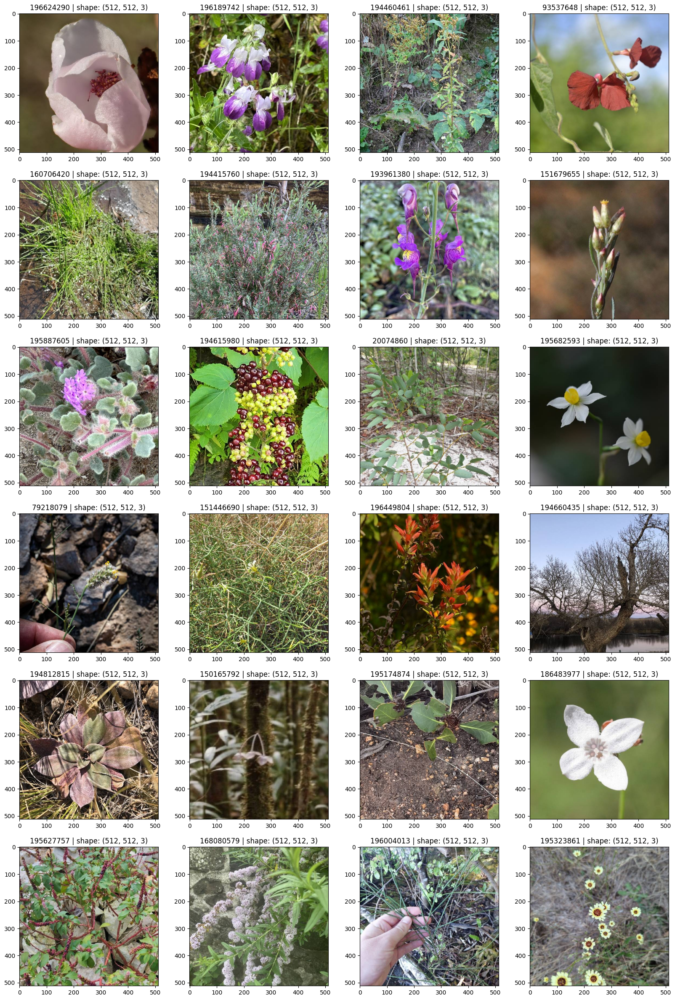

In [9]:
def plot_example(nrows=6, ncols=4):
    fig, axes = plt.subplots(nrows, ncols, figsize=(ncols*5, nrows*5))
    for r in range(nrows):
        for c in range(ncols):
            idx = (r * ncols) + c
            img = imageio.imread(train['jpeg_bytes'][idx])
            image_id = train['id'][idx]
            axes[r,c].imshow(img)
            axes[r,c].set_title(f'{image_id} | shape: {img.shape}')
            
    plt.show()
    
plot_example()

# Labels

In [10]:
# Labels Meta Data
target_name_meta = pd.read_csv('/kaggle/input/planttraits2024/target_name_meta.tsv', delimiter='\t')
target_name_meta['trait_ID'] = target_name_meta['trait_ID'] + '_mean'
target_name_meta = target_name_meta.set_index('trait_ID').squeeze().to_dict()

display(pd.Series(target_name_meta).to_frame())

,0
X4_mean,Stem specific density (SSD) or wood density (s...
X11_mean,Leaf area per leaf dry mass (specific leaf are...
X18_mean,Plant height
X26_mean,Seed dry mass
X50_mean,Leaf nitrogen (N) content per leaf area
X3112_mean,"Leaf area (in case of compound leaves: leaf, u..."


In [11]:
# Percentiles of features to use
percentiles = [
    0.001, 0.01,0.05,0.10,0.25,
    0.50,
    0.75,0.90,0.95,0.99, 0.999,
]
labels_describe_df = pd.DataFrame()
for target in CONFIG.TARGET_COLUMNS:
    labels_describe_df = pd.concat((
        labels_describe_df,
        train[target].describe(percentiles=percentiles).round(3)
    ), axis=1)
    
# Transpose DataFrame
labels_describe_df = labels_describe_df.T
    
# Minimum/Maximum Values
labels_describe_df.insert(4, 'v_min', CONFIG.V_MIN)
labels_describe_df.insert(16, 'v_max', CONFIG.V_MAX)
    
display(labels_describe_df)

,count,mean,std,min,v_min,0.1%,1%,5%,10%,25%,50%,75%,90%,95%,99%,99.9%,v_max,max
X4_mean,51393.0,0.522,1.760000e-01,-2.431,-0.416011,-0.416,0.227,0.304,0.339,0.411,0.508,0.622,0.724,0.796,0.918,1.447,1.446793,4.475000e+00
X11_mean,51393.0,141.735,1.328176e+04,0.000,0.516698,0.517,3.078,4.916,6.455,10.645,15.126,19.691,25.311,30.983,51.257,618.885,618.884844,1.504254e+06
X18_mean,51393.0,15975.172,2.078502e+06,0.000,0.005098,0.005,0.041,0.101,0.162,0.309,0.717,3.584,11.323,17.018,28.565,199.613,199.612717,2.720494e+08
X50_mean,51393.0,14.462,1.409496e+03,0.000,0.056425,0.056,0.486,0.774,0.923,1.173,1.480,1.926,2.494,3.036,4.480,39.876,39.876007,1.597599e+05
X26_mean,51393.0,3124.661,2.172520e+05,0.000,0.001079,0.001,0.011,0.047,0.119,0.559,2.511,14.955,79.011,218.550,1395.933,9667.620,9667.619594,3.106555e+07
X3112_mean,51393.0,428975.777,9.510196e+07,0.000,1.132863,1.133,11.180,42.309,89.349,255.021,726.080,2152.292,4844.885,8200.883,24695.882,453450.026,453450.025900,2.155911e+10


# Plot outliers

In [12]:
def plot_samples(target, df, n):
    rows = train0.sort_values(target, ascending=False).head(n)
    fig, axes = plt.subplots(1, n, figsize=(5*n, 5))
    plt.suptitle(f'{target} | {target_name_meta[target]}', size=24)
    for ax, (row_idx, row) in zip(axes, rows.iterrows()):
        ax.set_title(f'ID: {row.id}, {target}: {row[target]}', size=12)
        ax.imshow(imageio.imread(row['jpeg_bytes']))
        ax.axis('off')
    plt.show()

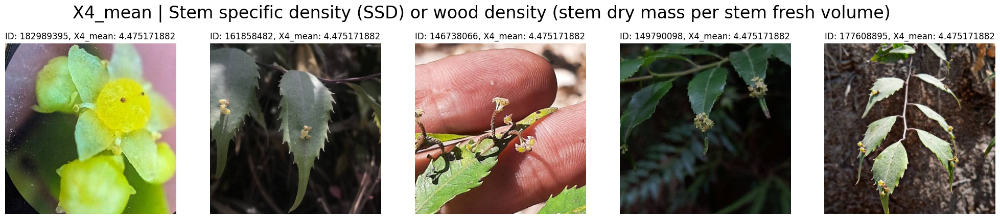

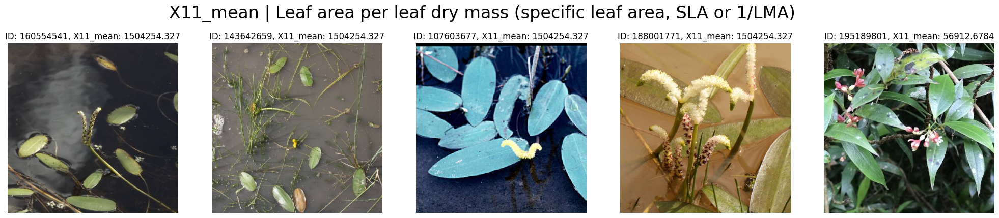

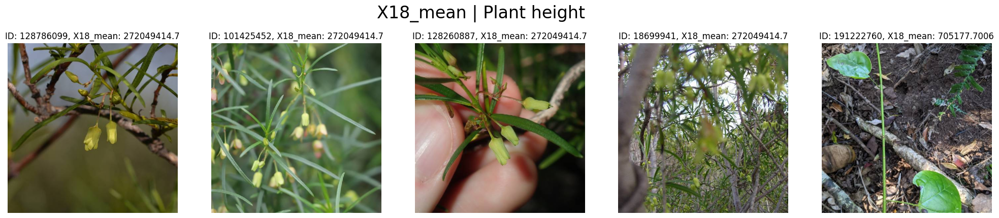

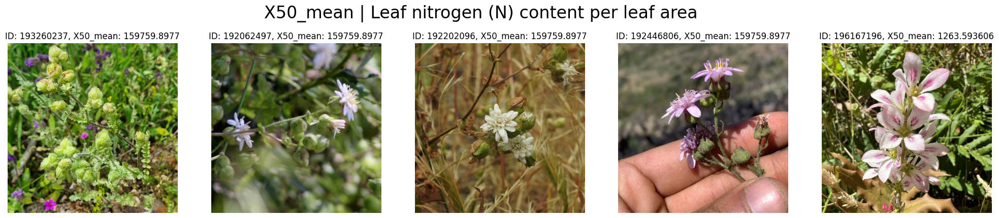

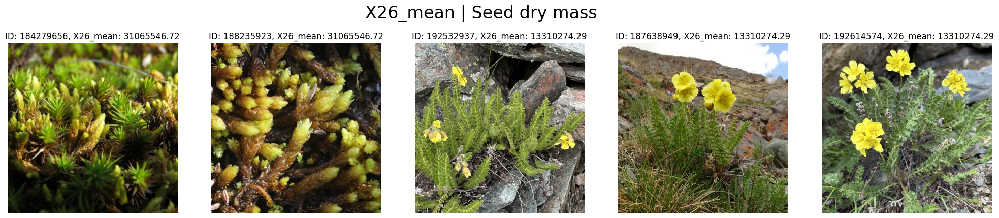

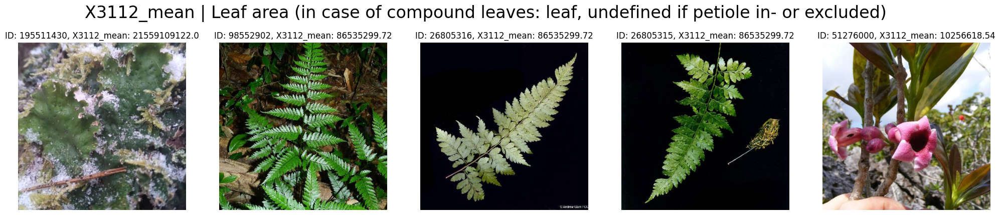

In [13]:
# As can be observer, whatever unit is used, the outliers are comically large
for target in CONFIG.TARGET_COLUMNS:
    plot_samples(target, train0, 5)

# Filter Outliers

In [14]:
# Mask to exclude values outside of 0.1% - 99.9% range
def get_mask(df):
    lower = []
    higher = []
    mask = np.empty(shape=df[CONFIG.TARGET_COLUMNS].shape, dtype=bool)
    # Fill mask based on minimum/maximum values of sample submission
    for idx, (t, v_min, v_max) in enumerate(zip(CONFIG.TARGET_COLUMNS, CONFIG.V_MIN, CONFIG.V_MAX)):
        labels = df[t].values
        mask[:,idx] = ((labels > v_min) & (labels < v_max))
    return mask.min(axis=1)

# Masks
CONFIG.MASK_TRAIN = get_mask(train)
CONFIG.MASK_VAL = get_mask(val)
# Masked DataFrames
train_mask = train[CONFIG.MASK_TRAIN].reset_index(drop=True)
val_mask = val[CONFIG.MASK_VAL].reset_index(drop=True)
# Add Number Of Steps
CONFIG.N_TRAIN_SAMPLES = len(train_mask)
CONFIG.N_VAL_SAMPLES = len(val_mask)
CONFIG.N_STEPS_PER_EPOCH = (CONFIG.N_TRAIN_SAMPLES // CONFIG.BATCH_SIZE)
CONFIG.N_VAL_STEPS_PER_EPOCH = math.ceil(CONFIG.N_VAL_SAMPLES / CONFIG.BATCH_SIZE_VAL)
CONFIG.N_STEPS = CONFIG.N_STEPS_PER_EPOCH * CONFIG.N_EPOCHS + 1

for m, subset in zip([CONFIG.MASK_TRAIN, CONFIG.MASK_VAL], ['train', 'val']):
    print(f'===== {subset} shape: {m.shape} =====')
    print(f'{subset} \t| # Masked Samples: {(1-m.mean())*CONFIG.N_TRAIN_SAMPLES:.0f}')
    print(f'{subset} \t| % Masked Samples: {100-m.mean()*100:.3f}%')

===== train shape: (51393,) =====
train 	| # Masked Samples: 333
train 	| % Masked Samples: 0.652%
===== val shape: (4096,) =====
val 	| # Masked Samples: 262
val 	| % Masked Samples: 0.513%


# Label Normalization

In [15]:
# Log Scale Features
LOG_FEATURES = ['X11_mean', 'X18_mean', 'X50_mean', 'X26_mean', 'X3112_mean']

In [16]:
# Fill labels using normalization tool
def fill_y(y, df, normalize=False):
    for target_idx, target in enumerate(CONFIG.TARGET_COLUMNS):
        v = df[target]
        if normalize:
            # Log10 Transform
            if target in LOG_FEATURES:
                v = np.log10(v)
            # Shift To Have Zero Median
            Y_SHIFT[target_idx] = np.mean(v)
            v = v - np.median(v)
            # Uniform Variance
            Y_STD[target_idx] = np.std(v)
            v = v / np.std(v)
        # Assign to y_train
        y[:,target_idx] = v

# Feature Scaler
Y_SHIFT = np.zeros(CONFIG.N_TARGETS)
Y_STD = np.zeros(CONFIG.N_TARGETS)
# Masked Labels
y_train_mask_raw = np.zeros_like(train_mask[CONFIG.TARGET_COLUMNS], dtype=np.float32)
y_train_mask = np.zeros_like(train_mask[CONFIG.TARGET_COLUMNS], dtype=np.float32)
y_val_mask = np.zeros_like(val_mask[CONFIG.TARGET_COLUMNS], dtype=np.float32)
# Fill Target Arrays
fill_y(y_train_mask_raw, train_mask, normalize=False)
fill_y(y_train_mask, train_mask, normalize=True)
fill_y(y_val_mask, val_mask, normalize=True)
# Values
display(pd.DataFrame({
    'y_shift': Y_SHIFT,
    'y_std': Y_STD
}, index=CONFIG.TARGET_COLUMNS))

,y_shift,y_std
X4_mean,0.525256,0.151960
X11_mean,1.142098,0.237343
X18_mean,0.008041,0.685711
X50_mean,0.177678,0.180489
X26_mean,0.459768,1.085055
X3112_mean,2.851682,0.674478


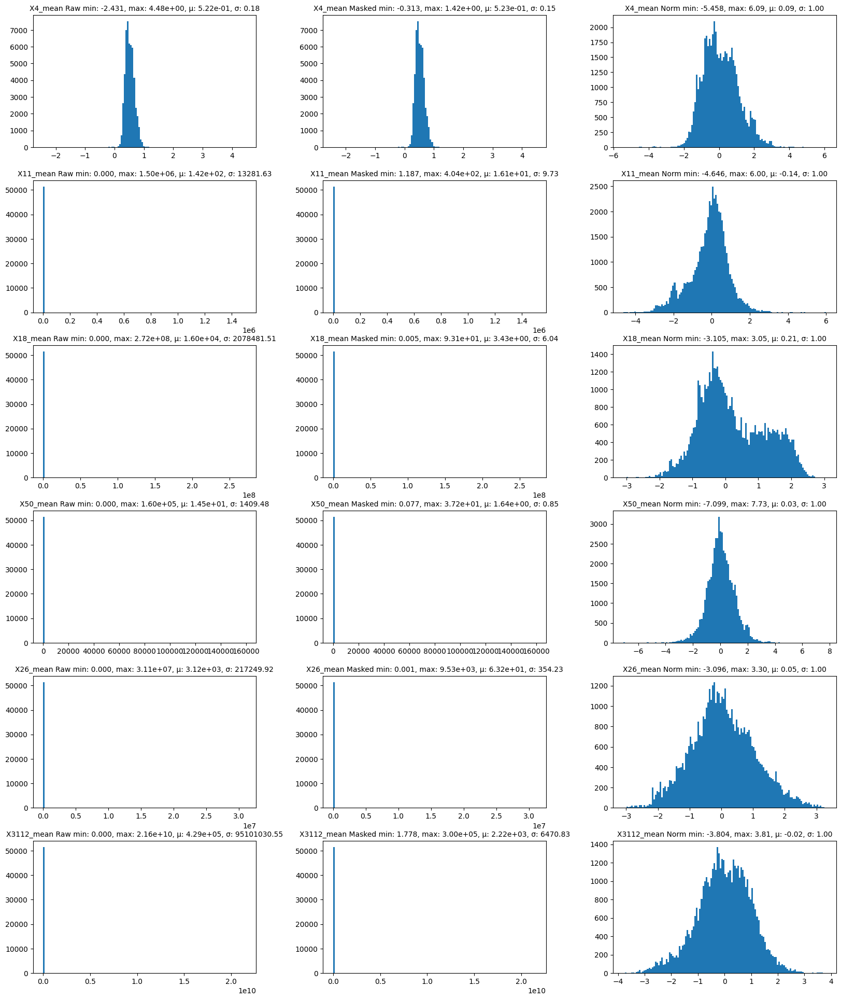

In [17]:
def plot_target_distribution():
    fig, axes = plt.subplots(CONFIG.N_TARGETS, 3, figsize=(20, CONFIG.N_TARGETS*4))
    v_raw = train[CONFIG.TARGET_COLUMNS].values
    for (ax_raw, ax_mask, ax_norm), target, v_r, v_n in zip(axes, CONFIG.TARGET_COLUMNS, v_raw.T, y_train_mask.T):
        # Raw
        ax_raw.hist(v_r, bins=128)
        ax_raw.set_title(f'{target} Raw min: {v_r.min():.3f}, max: {v_r.max():.2e}, µ: {v_r.mean():.2e}, σ: {v_r.std():.2f}', size=10)
        # Masked
        v_m = v_r[CONFIG.MASK_TRAIN]
        ax_mask.hist(v_r, bins=128)
        ax_mask.set_title(f'{target} Masked min: {v_m.min():.3f}, max: {v_m.max():.2e}, µ: {v_m.mean():.2e}, σ: {v_m.std():.2f}', size=10)
        # Normalized
        ax_norm.hist(v_n, bins=128)
        ax_norm.set_title(f'{target} Norm min: {v_n.min():.3f}, max: {v_n.max():.2f}, µ: {v_n.mean():.2f}, σ: {v_n.std():.2f}', size=10)
    plt.subplots_adjust(hspace=0.25, wspace=0.30)
    plt.show()
    
plot_target_distribution()

 # Features

In [18]:
# Standard Scaler for Features
FEATURE_SCALER = StandardScaler()

# Fit and transform on training features
train_features_mask = FEATURE_SCALER.fit_transform(train_mask[FEATURE_COLUMNS].values.astype(np.float32))
# Transform val/test features using scaler fitted on train data
val_features_mask = FEATURE_SCALER.transform(val_mask[FEATURE_COLUMNS].values.astype(np.float32))
test_features = FEATURE_SCALER.transform(test[FEATURE_COLUMNS].values.astype(np.float32))
# Convert Features to Torch Tensors
train_features_mask = torch.tensor(train_features_mask)
val_features_mask = torch.tensor(val_features_mask)
test_features = torch.tensor(test_features)

# Transforms

In [19]:
MEAN = np.array([0.485, 0.456, 0.406])
STD = np.array([0.229, 0.224, 0.225])
# Training Augmentations
TRAIN_TRANSFORMS = A.Compose([
        A.RandomSizedCrop(
            [int(0.85*CONFIG.IMAGE_SIZE0), CONFIG.IMAGE_SIZE0],
            CONFIG.IMAGE_SIZE, CONFIG.IMAGE_SIZE, w2h_ratio=1.0, p=1.0
        ),
        A.HorizontalFlip(p=0.50),
        A.RandomBrightnessContrast(brightness_limit=0.10, contrast_limit=0.10, p=0.50),
        A.ImageCompression(quality_lower=75, quality_upper=100, p=0.5),
        ToTensorV2(),
    ])
# Test Augmentations
VAL_TEST_TRANSFORMS = A.Compose([
        A.Resize(CONFIG.IMAGE_SIZE,CONFIG.IMAGE_SIZE),
        ToTensorV2(),
    ])

# Dataloader

In [20]:
class MyDataset(Dataset):
    def __init__(self, X_jpeg_bytes, y, features, transforms=None):
        self.X_jpeg_bytes = X_jpeg_bytes
        self.y = y
        self.features = features
        self.transforms = transforms

    def __len__(self):
        return len(self.X_jpeg_bytes)

    def __getitem__(self, index):
        X_sample = {
            'image': self.transforms(
                    image=imageio.imread(self.X_jpeg_bytes[index]),
                )['image'],
            'feature': self.features[index],
        }
        y_sample = self.y[index]
            
        return X_sample, y_sample

In [21]:
# Train
train_dataset = MyDataset(
    train_mask['jpeg_bytes'].values,
    y_train_mask,
    train_features_mask,
    TRAIN_TRANSFORMS,
)

train_dataloader = DataLoader(
        train_dataset,
        batch_size=CONFIG.BATCH_SIZE,
        drop_last=True,
        num_workers=psutil.cpu_count(),
    )
train_dataloader_iter = iter(train_dataloader)

# Validation
val_dataset = MyDataset(
    val_mask['jpeg_bytes'].values,
    y_val_mask,
    val_features_mask,
    VAL_TEST_TRANSFORMS,
)
val_dataloader = DataLoader(val_dataset, batch_size=CONFIG.BATCH_SIZE_VAL, drop_last=False)

# Test
test_dataset = MyDataset(
    test['jpeg_bytes'].values,
    test['id'].values,
    test_features,
    VAL_TEST_TRANSFORMS,
)

In [22]:
# Benchmark Dataset
N = 32
t_start = time.perf_counter_ns()
for _ in tqdm(range(N)):
    next(train_dataloader_iter)
n_images_per_second = (N * CONFIG.BATCH_SIZE) / (time.perf_counter_ns() - t_start) * 1e9
print(f'# Images/Second: {n_images_per_second:.0f}')

  0%|          | 0/32 [00:00<?, ?it/s]

# Images/Second: 556


In [23]:
# Example batch
X_batch, y_batch = next(train_dataloader_iter)
for k, v in X_batch.items():
    print(f'X_batch {k} shape: {v.shape}, dtype: {v.dtype}')
    print(f'X_batch {k} min: {v.min():.3f}, max: {v.max():.3f}')
    print(f'X_batch {k} µ: {v.float().mean():.3f}, σ: {v.float().std():.3f}')
# Label
print(f'y_batch shape: {y_batch.shape}, dtype: {y_batch.dtype}')
print(f'y_batch min: {y_batch.min():.3f}, max: {y_batch.max():.3f}')
print(f'y_batch µ: {y_batch.mean():.3f}, σ: {y_batch.std():.3f}')

X_batch image shape: torch.Size([24, 3, 288, 288]), dtype: torch.uint8
X_batch image min: 0.000, max: 255.000
X_batch image µ: 104.854, σ: 56.171
X_batch feature shape: torch.Size([24, 163]), dtype: torch.float32
X_batch feature min: -2.318, max: 7.694
X_batch feature µ: -0.054, σ: 0.927
y_batch shape: torch.Size([24, 6]), dtype: torch.float32
y_batch min: -2.832, max: 2.861
y_batch µ: -0.036, σ: 0.969


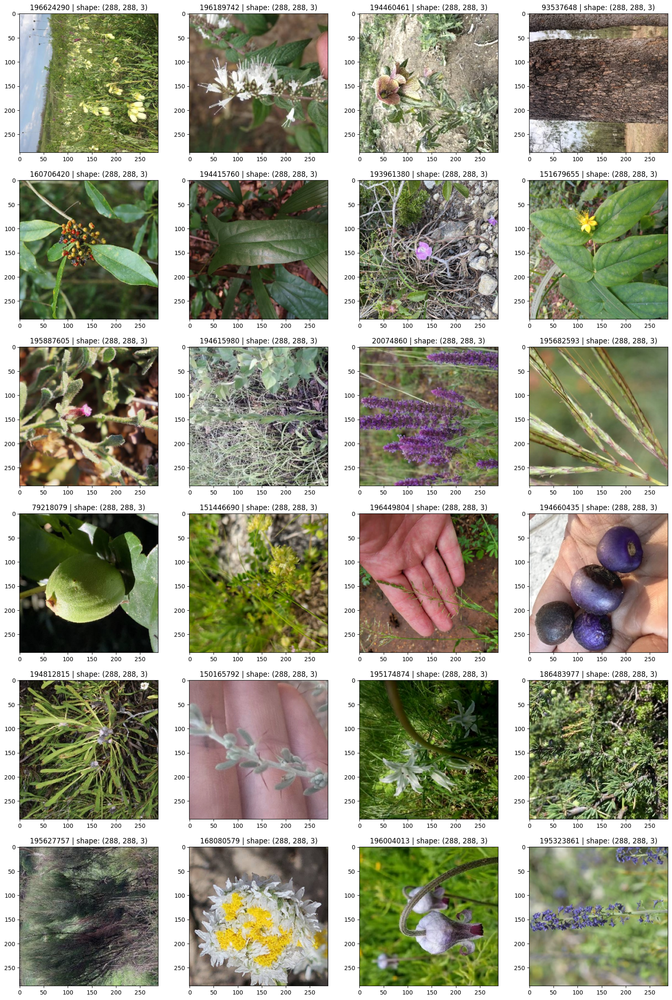

In [24]:
def plot_batch(nrows=6, ncols=4):
    fig, axes = plt.subplots(nrows, ncols, figsize=(ncols*5, nrows*5))
    for r in range(nrows):
        for c in range(ncols):
            idx = (r * ncols) + c
            # Put image on CPU
            img = X_batch['image'][idx].swapaxes(0,2).detach().cpu().numpy()
            # Denormalize Image
            image_id = train['id'][idx]
            axes[r,c].imshow(img)
            axes[r,c].set_title(f'{image_id} | shape: {img.shape}')
            
    plt.show()
    
plot_batch()

# Model

In [25]:
def search_timm_model(query):
    search_result = [n for n in timm.list_models(pretrained=True) if query in n]
    for i, name in enumerate(search_result):
        print(f'{i:02d} | {name}')
        
search_timm_model('efficientvit')

00 | efficientvit_b0.r224_in1k
01 | efficientvit_b1.r224_in1k
02 | efficientvit_b1.r256_in1k
03 | efficientvit_b1.r288_in1k
04 | efficientvit_b2.r224_in1k
05 | efficientvit_b2.r256_in1k
06 | efficientvit_b2.r288_in1k
07 | efficientvit_b3.r224_in1k
08 | efficientvit_b3.r256_in1k
09 | efficientvit_b3.r288_in1k
10 | efficientvit_l1.r224_in1k
11 | efficientvit_l2.r224_in1k
12 | efficientvit_l2.r256_in1k
13 | efficientvit_l2.r288_in1k
14 | efficientvit_l2.r384_in1k
15 | efficientvit_l3.r224_in1k
16 | efficientvit_l3.r256_in1k
17 | efficientvit_l3.r320_in1k
18 | efficientvit_l3.r384_in1k
19 | efficientvit_m0.r224_in1k
20 | efficientvit_m1.r224_in1k
21 | efficientvit_m2.r224_in1k
22 | efficientvit_m3.r224_in1k
23 | efficientvit_m4.r224_in1k
24 | efficientvit_m5.r224_in1k


In [26]:
# Count model parameters
def count_parameters(model):
    return sum([p.numel() for p in model.parameters()])

In [27]:
class Model(nn.Module):
    def __init__(self):
        super().__init__()
        # ImageNet Normalize Input
        self.normalize = transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
        
        # Backbone
        self.backbone = timm.create_model(
                'efficientvit_b1.r288_in1k',
                pretrained=True,
                num_classes=0,
            )
        
        # Features
        self.features = nn.Sequential(
            nn.Linear(CONFIG.N_FEATURES,256),
            nn.GELU(),
            nn.Linear(256,256),
        )
        
        # Label
        self.label = nn.Sequential(
            nn.Linear(256,256),
            nn.GELU(),
            nn.Linear(256,CONFIG.N_TARGETS, bias=False),
        )
        
        # Initialize Weights
        self.initialize_weights()
        
    def initialize_weights(self):
        # Features
        nn.init.kaiming_uniform_(self.features[2].weight)
        # Label
        nn.init.zeros_(self.label[2].weight)
        
    def forward(self, inputs, debug=False):
        if debug:
            embedding = self.backbone(self.normalize(inputs['image'].float() / 255))
            features = self.features(inputs['feature'])
            label = self.label(embedding + features)
            return {
                'features': features,
                'embedding': embedding,
                'label': label,
            }
        else:
            return {
                'label': self.label(
                    self.backbone(self.normalize(inputs['image'].float() / 255)) + self.features(inputs['feature'])
                )
            }

In [28]:
# Clear torch cache
torch.cuda.empty_cache()

# Load Weights if model is not trained
if not CONFIG.TRAIN_MODEL:
    model = torch.load('/kaggle/input/planttraits2024-eda-dataset/model.pth')
else:
    # Create new Model
    model = Model()

# Model to GPU memory
model = model.to('cuda')

print(f'# Model Parameters: {count_parameters(model):,}')

with torch.no_grad():
    # Put inputs on GPU
    for k, v in X_batch.items():
        X_batch[k] = v.to('cuda')
    outputs = model(X_batch, debug=True)
    for k, v in outputs.items():
        print(f'outputs {k} shape: {v.shape}, min: {v.min():.3f}, max: {v.max():.3f}, µ: {v.mean():.3f}, σ: {v.std():.3f}')
    # Label Outputs
    for o in outputs['label'][:3,:]:
        print(o.detach().cpu().numpy().tolist())

model.safetensors:   0%|          | 0.00/36.5M [00:00<?, ?B/s]

# Model Parameters: 4,819,040
outputs features shape: torch.Size([24, 256]), min: -2.857, max: 2.721, µ: -0.009, σ: 0.443
outputs embedding shape: torch.Size([24, 256]), min: -5.611, max: 4.163, µ: -0.015, σ: 0.762
outputs label shape: torch.Size([24, 6]), min: 0.000, max: 0.000, µ: 0.000, σ: 0.000
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


# Learning Rate Schedule

In [29]:
# Get the learning rate scheduler
def get_lr_scheduler(optimizer):
    return torch.optim.lr_scheduler.OneCycleLR(
        optimizer=optimizer,
        max_lr=CONFIG.LR_MAX,
        total_steps=CONFIG.N_STEPS,
        pct_start=0.10,
        anneal_strategy='cos',
        div_factor=1e3,
        final_div_factor=1e4,
    )

/opt/conda/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:136: UserWarning: Detected call of `lr_scheduler.step()` before `optimizer.step()`. In PyTorch 1.1.0 and later, you should call them in the opposite order: `optimizer.step()` before `lr_scheduler.step()`.  Failure to do this will result in PyTorch skipping the first value of the learning rate schedule. See more details at https://pytorch.org/docs/stable/optim.html#how-to-adjust-learning-rate
  warnings.warn("Detected call of `lr_scheduler.step()` before `optimizer.step()`. "


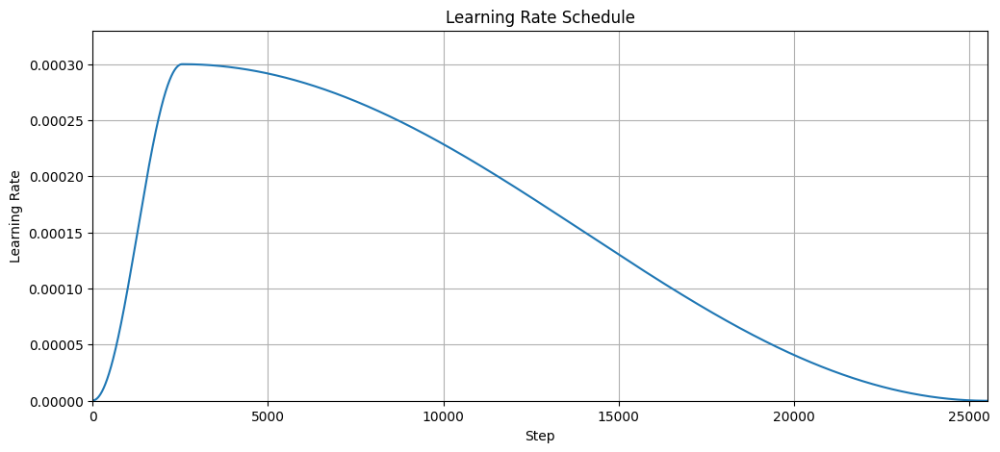

In [30]:
# Plot Learning Rate Scheduler
def plot_lr_scheduler():
    lr_scheduler = get_lr_scheduler(torch.optim.Adam(model.parameters()))
    lrs  = []
    for step in range(CONFIG.N_STEPS):
        lrs.append(lr_scheduler.get_last_lr())
        lr_scheduler.step()
    # Plot Learning Rate
    plt.figure(figsize=(12,5))
    plt.title('Learning Rate Schedule')
    plt.xlim(0, CONFIG.N_STEPS)
    plt.ylim(0, CONFIG.LR_MAX*1.1)
    plt.xlabel('Step')
    plt.ylabel('Learning Rate')
    plt.plot(lrs)
    plt.grid()
    plt.show()
    # Reset Learning Rate Scheduler
    lr_scheduler._step_count = 0
    lr_scheduler.last_epoch = 0

plot_lr_scheduler()

# Metrics

In [31]:
# Average meter to keep track of metrics/loss during training
class AverageMeter(object):
    def __init__(self):
        self.reset()

    def reset(self):
        self.avg = 0
        self.sum = 0
        self.count = 0

    def update(self, val):
        self.sum += val.sum()
        self.count += val.numel()
        # Average is simply the sum divided by the count
        self.avg = self.sum / self.count

In [32]:
# Average meter to keep track of metrics/loss during training
class R2_METRIC(object):
    def __init__(self):
        self.reset()
        self.y_mean = torch.tensor(train0[CONFIG.TARGET_COLUMNS].median(axis=0).values).to('cuda')

    def reset(self):
        self.avg = torch.zeros(CONFIG.N_TARGETS).to('cuda')
        self.rss = torch.zeros(CONFIG.N_TARGETS).to('cuda')
        self.tss = torch.zeros(CONFIG.N_TARGETS).to('cuda')

    def update(self, y_pred, y_true, mean=False):
        self.rss += torch.sum((y_true - y_pred)**2, dim=0)
        self.tss += torch.sum((y_true - self.y_mean)**2, dim=0)
        self.avg = 1 - (self.rss / torch.maximum(self.tss, CONFIG.EPS_CUDA))

# Loss

In [33]:
# Y_SHIFT As Torch Tensor On GPU
Y_SHIFT_CUDA = torch.tensor(Y_SHIFT).to('cuda')
Y_STD_CUDA = torch.tensor(Y_STD).to('cuda')
# Is Log Feature Flag
IS_LOG_FEATURE = torch.tensor(np.isin(CONFIG.TARGET_COLUMNS, LOG_FEATURES)).to('cuda')

def denormalize(y_pred, y_true=None):
    # Scale Back
    y_pred = (y_pred * Y_STD_CUDA) + Y_SHIFT_CUDA
    # Log Scale
    y_pred = torch.where(IS_LOG_FEATURE, 10**y_pred, y_pred)
    # Optionally Denormalize y_true
    if y_true is not None:
        y_true = (y_true * Y_STD_CUDA) + Y_SHIFT_CUDA
        y_true = torch.where(IS_LOG_FEATURE, 10**y_true, y_true)
        return y_pred, y_true
    else:
        return y_pred

In [34]:
# Mean feature values used to compute R2 loss
Y_MEDIAN = torch.tensor(CONFIG.TARGET_MEDIANS).to('cuda')
# Total Variation
MEAN_VARIATION = torch.tensor(
        (CONFIG.TARGET_MEDIANS - y_train_mask_raw)
    ).abs().mean(dim=0).to('cuda')
# R2 Loss
def r2_loss_fn(y_pred, y_true):
    B = len(y_pred)
    # Compute column wise sum of residuals and totals
    ss_res = (y_true - y_pred)**2
    ss_total = (y_true - Y_MEDIAN)**2
    # r2 ranging from 0 to infinity
    loss = torch.sum(ss_res, dim=0) / torch.maximum(torch.sum(ss_total, dim=0), CONFIG.EPS_CUDA)
    # Return Mean Of Loss
    return torch.mean(loss)

r2_loss_fn(denormalize(outputs['label']), denormalize(y_batch.to('cuda')))

tensor(0.9714, device='cuda:0', dtype=torch.float64)

In [35]:
def validation_step():
    # Loss Function
    R2_LOSS_FN = r2_loss_fn
    # Put model in evaluation mode
    model.eval()
    # Metrics Trackers
    R2 = R2_METRIC()
    R2_LOSS = AverageMeter()
    # Iterave Over Validation Set
    for step, (X_sample, y_true) in enumerate(val_dataloader):
        y_true = y_true.to('cuda')
        # Put label on GPU
        with torch.no_grad():
            for k, v in X_sample.items():
                X_sample[k] = v.to('cuda')
            # Forward Pass
            y_pred = model(X_sample)['label']
        # Denormalize
        y_pred_raw, y_true_raw = denormalize(y_pred, y_true)
        # Loss
        r2_loss = R2_LOSS_FN(y_pred_raw, y_true_raw)
        # Update Loss Metrics
        R2_LOSS.update(r2_loss)
        # Update Metrics
        R2.update(y_pred_raw, y_true_raw)
        # Logs
        r2_str = ", ".join(
            [f"{f}: {v:+.3f}" for f, v in zip(CONFIG.TARGET_COLUMNS_TEST, R2.avg)
        ])
        if not CONFIG.IS_INTERACTIVE and (step + 1) == CONFIG.N_VAL_STEPS_PER_EPOCH:
            print(
                f'VAL | R2 loss: {R2_LOSS.avg:.4f}, R2: {R2.avg.mean():.3f}, {r2_str}' + (' ' * 10)
            )
        elif CONFIG.IS_INTERACTIVE:
            print(
                f'\rVAL {step+1:02d}/{CONFIG.N_VAL_STEPS_PER_EPOCH} | R2 loss: {R2_LOSS.avg:.4f}, ' +
                f'R2: {R2.avg.mean():.3f}, {r2_str}' + (' ' * 10),
                end='\n' if (step + 1) == CONFIG.N_VAL_STEPS_PER_EPOCH else '', flush=True,
            )
    
validation_step()

VAL 32/32 | R2 loss: 0.9896, R2: 0.010, X4: +0.026, X11: -0.007, X18: +0.026, X50: +0.014, X26: +0.000, X3112: -0.002          


# Training

In [36]:
# Loss
R2_LOSS_FN = r2_loss_fn
# Optimizer
optimizer = torch.optim.AdamW(
    params=model.parameters(),
    lr=CONFIG.LR_MAX,
    weight_decay=CONFIG.WEIGHT_DECAY,
)
# Learning Rate Scheduler
LR_SCHEDULER = get_lr_scheduler(optimizer)
# Metrics Trackers
R2 = R2_METRIC()
R2_LOSS = AverageMeter()

In [37]:
if CONFIG.TRAIN_MODEL:
    for epoch in range(CONFIG.N_EPOCHS):
        # Reset Metrics
        R2.reset()
        R2_LOSS.reset()
        # Put model in training mode
        model.train()
        # Iterate Over Training Dataloader
        for step, (X_batch, y_true) in enumerate(train_dataloader):
            # Put batch on GPU
            for k, v in X_batch.items():
                X_batch[k] = v.to('cuda')
            y_true = y_true.to('cuda')
            # Step Time
            t_start = time.perf_counter_ns()
            # Forward Pass
            y_pred = model(X_batch)['label']
            # Denormalize
            y_pred_raw, y_true_raw = denormalize(y_pred, y_true)
            # Loss
            r2_loss = R2_LOSS_FN(y_pred_raw, y_true_raw)
            # Update Loss Metrics
            R2_LOSS.update(r2_loss)
            # Compute Gradients
            r2_loss.backward()
            # Backward Pass
            optimizer.step()
            # Zero Out Gradients
            optimizer.zero_grad()
            # Update Metrics
            R2.update(y_pred_raw, y_true_raw)
            # Compute R2 Metrics String
            r2_str = ", ".join([
                f"{f}: {v:+.3f}" for f, v in zip(CONFIG.TARGET_COLUMNS_TEST, R2.avg)
            ])
            # Logs
            if not CONFIG.IS_INTERACTIVE and (step + 1) == CONFIG.N_STEPS_PER_EPOCH:
                print(
                    f'EPOCH {epoch+1:02d} {step+1:04d}/{CONFIG.N_STEPS_PER_EPOCH} | ' + 
                    f'R2 loss: {R2_LOSS.avg:.4f}, R2: {R2.avg.mean():+.3f}, {r2_str}, ' +
                    f'step: {(time.perf_counter_ns()-t_start)*1e-9:.3f}s, lr: {LR_SCHEDULER.get_last_lr()[0]:.2e}',
                )
            elif CONFIG.IS_INTERACTIVE:
                print(
                    f'\rEPOCH {epoch+1:02d} {step+1:04d}/{CONFIG.N_STEPS_PER_EPOCH} | ' + 
                    f'R2 loss: {R2_LOSS.avg:.4f}, R2: {R2.avg.mean():+.3f}, {r2_str}, ' +
                    f'step: {(time.perf_counter_ns()-t_start)*1e-9:.3f}s, lr: {LR_SCHEDULER.get_last_lr()[0]:.2e}',
                    end='\n' if (step + 1) == CONFIG.N_STEPS_PER_EPOCH else '', flush=True,
                )
            # Learning Rate Scheduler Step
            LR_SCHEDULER.step()
        # Validation Step
        validation_step()

# Save entire model object
torch.save(model, 'model.pth')

EPOCH 01 2127/2127 | R2 loss: 0.8225, R2: +0.138, X4: +0.199, X11: +0.120, X18: +0.305, X50: +0.112, X26: +0.008, X3112: +0.081, step: 0.136s, lr: 2.80e-04
VAL 32/32 | R2 loss: 0.8046, R2: 0.173, X4: +0.241, X11: +0.128, X18: +0.417, X50: +0.146, X26: +0.013, X3112: +0.093          
EPOCH 02 2127/2127 | R2 loss: 0.7525, R2: +0.194, X4: +0.282, X11: +0.185, X18: +0.415, X50: +0.158, X26: +0.013, X3112: +0.110, step: 0.136s, lr: 2.96e-04
VAL 32/32 | R2 loss: 0.7934, R2: 0.180, X4: +0.237, X11: +0.147, X18: +0.411, X50: +0.145, X26: +0.014, X3112: +0.126          
EPOCH 03 2127/2127 | R2 loss: 0.7243, R2: +0.214, X4: +0.306, X11: +0.203, X18: +0.464, X50: +0.171, X26: +0.018, X3112: +0.123, step: 0.136s, lr: 2.80e-04
VAL 32/32 | R2 loss: 0.7786, R2: 0.192, X4: +0.248, X11: +0.151, X18: +0.421, X50: +0.169, X26: +0.020, X3112: +0.142          
EPOCH 04 2127/2127 | R2 loss: 0.7004, R2: +0.230, X4: +0.326, X11: +0.219, X18: +0.495, X50: +0.185, X26: +0.022, X3112: +0.134, step: 0.136s, lr: 2

In [38]:
# Save entire model object
torch.save(model, 'model.pth')

# Test

In [39]:
# Minimum And Maximum Values To Clip Predictions
TARGET_MIN = train0[CONFIG.TARGET_COLUMNS].values.min(axis=0)
TARGET_MAX = train0[CONFIG.TARGET_COLUMNS].values.max(axis=0)
# Submission Rows
SUBMISSION_ROWS = []
# Put Model in Evaluation Mode
model.eval()
for i, (X_sample_test, test_id) in enumerate(tqdm(test_dataset)):
    # Only 100 predictions in interactive mode
    if CONFIG.IS_INTERACTIVE and i == 100:
        break
    # Put sample on GPU and add batch dimension
    for k, v in X_sample_test.items():
        X_sample_test[k] = v.to('cuda').unsqueeze(0)
    # Prediction without gradients
    with torch.no_grad():
        y_pred = model(X_sample_test)['label']
    # Reverse Scaling
    y_pred, _ = denormalize(y_pred, y_pred)
    y_pred = y_pred.detach().cpu().numpy().squeeze()
    # Clip Values
    y_pred = np.clip(y_pred, TARGET_MIN, TARGET_MAX)
    # Add To Rows
    row = { 'id': test_id }
    # Add Predictions column by column
    for k, v in zip(CONFIG.TARGET_COLUMNS, y_pred):
        # Remove "_mean" part of target column
        row[k.replace('_mean', '')] = v
    # Add To Submission Rows
    SUBMISSION_ROWS.append(row)

  0%|          | 0/6545 [00:00<?, ?it/s]

In [ ]:
# Make Submission CSV
submission_df = pd.DataFrame(SUBMISSION_ROWS)

display(submission_df.head(30))

# Make
submission_df.to_csv('submission.csv', index=False)